In [6]:
# Check nvcc version
!nvcc -V
# Check GCC version
!gcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Tue_Mar__8_18:18:20_PST_2022
Cuda compilation tools, release 11.6, V11.6.124
Build cuda_11.6.r11.6/compiler.31057947_0
gcc (Ubuntu 11.3.0-1ubuntu1~22.04.1) 11.3.0
Copyright (C) 2021 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [ ]:
# # 安装 mmengine 和 mmcv 依赖
# # 为了防止后续版本变更导致的代码无法运行，我们暂时锁死版本
# !pwd
# %pip install -U "openmim==0.3.7"
# !mim install "mmengine==0.7.1"
# !mim install "mmcv==2.0.0"

# # Install mmdetection
# !rm -rf mmdetection
# # 为了防止后续更新导致的可能无法运行，特意新建了 tutorials 分支
# !git clone -b tutorials https://github.com/open-mmlab/mmdetection.git
# %cd mmdetection

# %pip install -e .

In [7]:
from mmengine.utils import get_git_hash
from mmengine.utils.dl_utils import collect_env as collect_base_env

import mmdet

# 环境信息收集和打印
def collect_env():
    """Collect the information of the running environments."""
    env_info = collect_base_env()
    env_info['MMDetection'] = f'{mmdet.__version__}+{get_git_hash()[:7]}'
    return env_info


if __name__ == '__main__':
    for name, val in collect_env().items():
        print(f'{name}: {val}')

sys.platform: linux
Python: 3.8.16 (default, Mar  2 2023, 03:21:46) [GCC 11.2.0]
CUDA available: True
numpy_random_seed: 4234130559
GPU 0: NVIDIA GeForce GTX 1080 Ti
CUDA_HOME: /usr/local/cuda-11.6
NVCC: Cuda compilation tools, release 11.6, V11.6.124
GCC: gcc (Ubuntu 11.3.0-1ubuntu1~22.04.1) 11.3.0
PyTorch: 1.10.1+cu113
PyTorch compiling details: PyTorch built with:
  - GCC 7.3
  - C++ Version: 201402
  - Intel(R) Math Kernel Library Version 2020.0.0 Product Build 20191122 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v2.2.3 (Git Hash 7336ca9f055cf1bfa13efb658fe15dc9b41f0740)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled (usually provided by MKL)
  - NNPACK is enabled
  - CPU capability usage: AVX2
  - CUDA Runtime 11.3
  - NVCC architecture flags: -gencode;arch=compute_37,code=sm_37;-gencode;arch=compute_50,code=sm_50;-gencode;arch=compute_60,code=sm_60;-gencode;arch=compute_70,code=sm_70;-gencode;arch=compute_75,code=sm_75;-gencode;arch=compute_80,code

In [1]:
%cd mmdetection/

/home/cine/Documents/GitHub/mmdet/mmdetection


In [ ]:
# # 数据集下载
# !rm -rf cat_dataset*
# !wget https://download.openmmlab.com/mmyolo/data/cat_dataset.zip
# !unzip cat_dataset.zip -d cat_dataset && rm cat_dataset.zip 

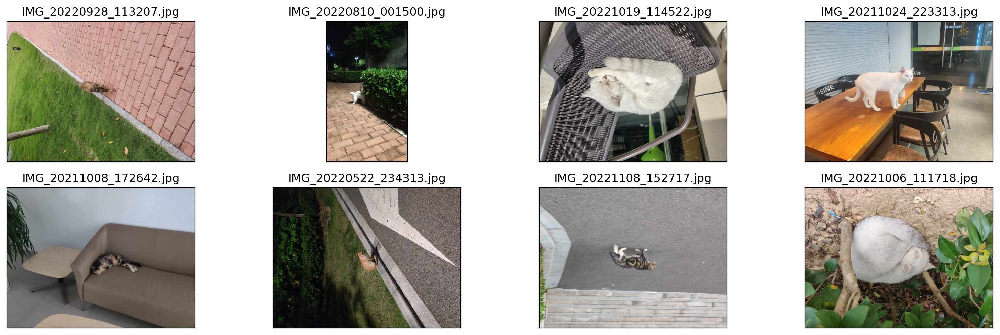

In [2]:
# 数据集可视化

import os
import matplotlib.pyplot as plt
from PIL import Image

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

original_images = []
images = []
texts = []
plt.figure(figsize=(16, 5))

image_paths= [filename for filename in os.listdir('cat_dataset/images')][:8]

for i,filename in enumerate(image_paths):
    name = os.path.splitext(filename)[0]

    image = Image.open('cat_dataset/images/'+filename).convert("RGB")
  
    plt.subplot(2, 4, i+1)
    plt.imshow(image)
    plt.title(f"{filename}")
    plt.xticks([])
    plt.yticks([])

plt.tight_layout()

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


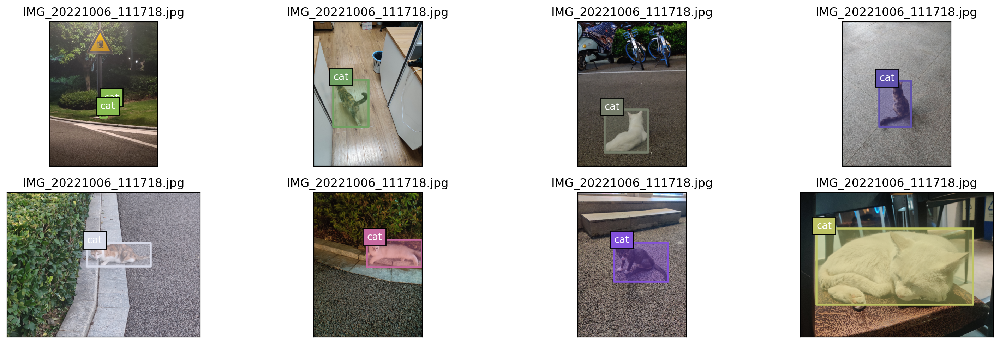

In [3]:
# COCO Json 可视化
from pycocotools.coco import COCO
import numpy as np
import os.path as osp
from matplotlib.collections import PatchCollection
from matplotlib.patches import Polygon

def apply_exif_orientation(image):
    _EXIF_ORIENT = 274
    if not hasattr(image, 'getexif'):
        return image

    try:
        exif = image.getexif()
    except Exception:
        exif = None

    if exif is None:
        return image

    orientation = exif.get(_EXIF_ORIENT)

    method = {
        2: Image.FLIP_LEFT_RIGHT,
        3: Image.ROTATE_180,
        4: Image.FLIP_TOP_BOTTOM,
        5: Image.TRANSPOSE,
        6: Image.ROTATE_270,
        7: Image.TRANSVERSE,
        8: Image.ROTATE_90,
    }.get(orientation)
    if method is not None:
        return image.transpose(method)
    return image


def show_bbox_only(coco, anns, show_label_bbox=True, is_filling=True):
    """Show bounding box of annotations Only."""
    if len(anns) == 0:
        return

    ax = plt.gca()
    ax.set_autoscale_on(False)

    image2color = dict()
    for cat in coco.getCatIds():
        image2color[cat] = (np.random.random((1, 3)) * 0.7 + 0.3).tolist()[0]

    polygons = []
    colors = []

    for ann in anns:
        color = image2color[ann['category_id']]
        bbox_x, bbox_y, bbox_w, bbox_h = ann['bbox']
        poly = [[bbox_x, bbox_y], [bbox_x, bbox_y + bbox_h],
                [bbox_x + bbox_w, bbox_y + bbox_h], [bbox_x + bbox_w, bbox_y]]
        polygons.append(Polygon(np.array(poly).reshape((4, 2))))
        colors.append(color)

        if show_label_bbox:
            label_bbox = dict(facecolor=color)
        else:
            label_bbox = None

        ax.text(
            bbox_x,
            bbox_y,
            '%s' % (coco.loadCats(ann['category_id'])[0]['name']),
            color='white',
            bbox=label_bbox)

    if is_filling:
        p = PatchCollection(
            polygons, facecolor=colors, linewidths=0, alpha=0.4)
        ax.add_collection(p)
    p = PatchCollection(
        polygons, facecolor='none', edgecolors=colors, linewidths=2)
    ax.add_collection(p)

    
coco = COCO('cat_dataset/annotations/test.json')
image_ids = coco.getImgIds()
np.random.shuffle(image_ids)

plt.figure(figsize=(16, 5))

# 只可视化 8 张图片
for i in range(8):
    image_data = coco.loadImgs(image_ids[i])[0]
    image_path = osp.join('cat_dataset/images/',image_data['file_name'])
    annotation_ids = coco.getAnnIds(
            imgIds=image_data['id'], catIds=[], iscrowd=0)
    annotations = coco.loadAnns(annotation_ids)
    
    ax = plt.subplot(2, 4, i+1)
    image = Image.open(image_path).convert("RGB")
    
    # 这行代码很关键，否则可能图片和标签对不上
    image=apply_exif_orientation(image)
    
    ax.imshow(image)
    
    show_bbox_only(coco, annotations)
    
    plt.title(f"{filename}")
    plt.xticks([])
    plt.yticks([])
        
plt.tight_layout()    

In [4]:
# 当前路径位于 mmdetection/tutorials, 配置将写到 mmdetection/tutorials 路径下

config_cat = """
_base_ = 'configs/rtmdet/rtmdet_tiny_8xb32-300e_coco.py'

data_root = 'cat_dataset/'

# 非常重要
metainfo = {
    # 类别名，注意 classes 需要是一个 tuple，因此即使是单类，
    # 你应该写成 `cat,` 很多初学者经常会在这犯错
    'classes': ('cat',),
    'palette': [
        (220, 20, 60),
    ]
}
num_classes = 1

# 训练 40 epoch
max_epochs = 40
# 训练单卡 bs= 12
train_batch_size_per_gpu = 12
# 可以根据自己的电脑修改
train_num_workers = 4

# 验证集 batch size 为 1
val_batch_size_per_gpu = 1
val_num_workers = 2

# RTMDet 训练过程分成 2 个 stage，第二个 stage 会切换数据增强 pipeline
num_epochs_stage2 = 5

# batch 改变了，学习率也要跟着改变， 0.004 是 8卡x32 的学习率
base_lr = 12 * 0.004 / (32*8)

# 采用 COCO 预训练权重
load_from = 'https://download.openmmlab.com/mmdetection/v3.0/rtmdet/rtmdet_tiny_8xb32-300e_coco/rtmdet_tiny_8xb32-300e_coco_20220902_112414-78e30dcc.pth'  # noqa

model = dict(
    # 考虑到数据集太小，且训练时间很短，我们把 backbone 完全固定
    # 用户自己的数据集可能需要解冻 backbone
    backbone=dict(frozen_stages=4),
    # 不要忘记修改 num_classes
    bbox_head=dict(dict(num_classes=num_classes)))

# 数据集不同，dataset 输入参数也不一样
train_dataloader = dict(
    batch_size=train_batch_size_per_gpu,
    num_workers=train_num_workers,
    pin_memory=False,
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        ann_file='annotations/trainval.json',
        data_prefix=dict(img='images/')))

val_dataloader = dict(
    batch_size=val_batch_size_per_gpu,
    num_workers=val_num_workers,
    dataset=dict(
        metainfo=metainfo,
        data_root=data_root,
        ann_file='annotations/test.json',
        data_prefix=dict(img='images/')))

test_dataloader = val_dataloader

# 默认的学习率调度器是 warmup 1000，但是 cat 数据集太小了，需要修改 为 30 iter
param_scheduler = [
    dict(
        type='LinearLR',
        start_factor=1.0e-5,
        by_epoch=False,
        begin=0,
        end=30),
    dict(
        type='CosineAnnealingLR',
        eta_min=base_lr * 0.05,
        begin=max_epochs // 2,  # max_epoch 也改变了
        end=max_epochs,
        T_max=max_epochs // 2,
        by_epoch=True,
        convert_to_iter_based=True),
]
optim_wrapper = dict(optimizer=dict(lr=base_lr))

# 第二 stage 切换 pipeline 的 epoch 时刻也改变了
_base_.custom_hooks[1].switch_epoch = max_epochs - num_epochs_stage2

val_evaluator = dict(ann_file=data_root + 'annotations/test.json')
test_evaluator = val_evaluator

# 一些打印设置修改
default_hooks = dict(
    checkpoint=dict(interval=10, max_keep_ckpts=2, save_best='auto'),  # 同时保存最好性能权重
    logger=dict(type='LoggerHook', interval=5))
train_cfg = dict(max_epochs=max_epochs, val_interval=10)
"""

with open('rtmdet_tiny_1xb12-40e_cat.py', 'w') as f:
    f.write(config_cat)

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
06/10 13:05:26 - mmengine - WARNING - `Visualizer` backend is not initialized because save_dir is None.


/home/cine/Documents/GitHub/mmdet/mmdetection/mmdet/visualization/palette.py:90: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  scales = 0.5 + (areas - min_area) // (max_area - min_area)
/home/cine/miniconda3/envs/openmmlab-pose/lib/python3.8/site-packages/mmengine/visualization/visualizer.py:741: UserWarning: Warning: The bbox is out of bounds, the drawn bbox may not be in the image
  warnings.warn(
/home/cine/miniconda3/envs/openmmlab-pose/lib/python3.8/site-packages/mmengine/visualization/visualizer.py:812: UserWarning: Warning: The polygon is out of bounds, the drawn polygon may not be in the image
  warnings.warn(


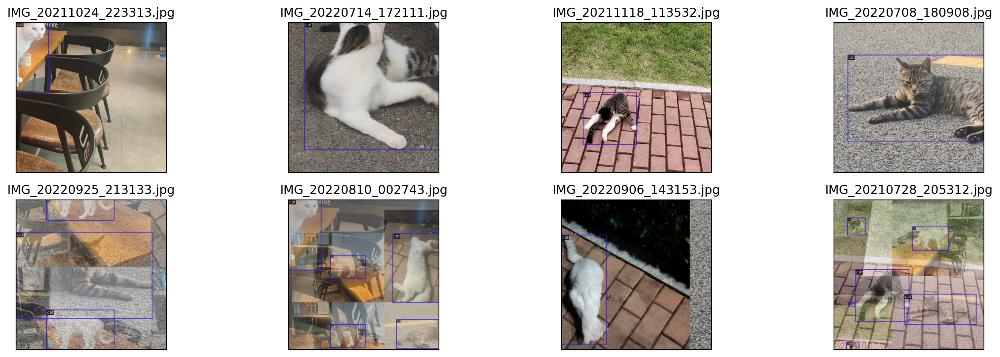

In [5]:
# # 训练前可视化验证
# 我们可以采用 mmdet 提供的 tools/analysis_tools/browse_dataset.py 
# 脚本来对训练前的 dataloader 输出进行可视化，确保数据部分没有问题。 
# 考虑到我们仅仅想可视化前几张图片，
# 因此下面基于 browse_dataset.py 实现一个简单版本即可


from mmdet.registry import DATASETS, VISUALIZERS
from mmengine.config import Config
from mmengine.registry import init_default_scope

cfg = Config.fromfile('rtmdet_tiny_1xb12-40e_cat.py')

init_default_scope(cfg.get('default_scope', 'mmdet'))

dataset = DATASETS.build(cfg.train_dataloader.dataset)
visualizer = VISUALIZERS.build(cfg.visualizer)
visualizer.dataset_meta = dataset.metainfo

plt.figure(figsize=(16, 5))

# 只可视化前 8 张图片
for i in range(8):
    item=dataset[i]

    img = item['inputs'].permute(1, 2, 0).numpy()
    data_sample = item['data_samples'].numpy()
    gt_instances = data_sample.gt_instances
    img_path = osp.basename(item['data_samples'].img_path)

    gt_bboxes = gt_instances.get('bboxes', None)
    gt_instances.bboxes = gt_bboxes.tensor
    data_sample.gt_instances = gt_instances

    visualizer.add_datasample(
            osp.basename(img_path),
            img,
            data_sample,
            draw_pred=False,
            show=False)
    drawed_image=visualizer.get_image()

    plt.subplot(2, 4, i+1)
    plt.imshow(drawed_image[..., [2, 1, 0]])
    plt.title(f"{osp.basename(img_path)}")
    plt.xticks([])
    plt.yticks([])

plt.tight_layout()    

In [2]:
# 模型训练
!python tools/train.py rtmdet_tiny_1xb12-40e_cat.py

06/10 00:00:35 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.8.16 (default, Mar  2 2023, 03:21:46) [GCC 11.2.0]
    CUDA available: True
    numpy_random_seed: 836165902
    GPU 0: NVIDIA GeForce GTX 1080 Ti
    CUDA_HOME: /usr/local/cuda-11.6
    NVCC: Cuda compilation tools, release 11.6, V11.6.124
    GCC: gcc (Ubuntu 11.3.0-1ubuntu1~22.04.1) 11.3.0
    PyTorch: 1.10.1+cu113
    PyTorch compiling details: PyTorch built with:
  - GCC 7.3
  - C++ Version: 201402
  - Intel(R) Math Kernel Library Version 2020.0.0 Product Build 20191122 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v2.2.3 (Git Hash 7336ca9f055cf1bfa13efb658fe15dc9b41f0740)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled (usually provided by MKL)
  - NNPACK is enabled
  - CPU capability usage: AVX2
  - CUDA Runtime 11.3
  - NVCC architecture flags: -gencode;arch=compute_37,code=sm_37;-gencode;arch=com

06/10 00:00:41 - mmengine - INFO - Distributed training is not used, all SyncBatchNorm (SyncBN) layers in the model will be automatically reverted to BatchNormXd layers if they are used.
06/10 00:00:41 - mmengine - INFO - Hooks will be executed in the following order:
before_run:
(VERY_HIGH   ) RuntimeInfoHook                    
(49          ) EMAHook                            
(BELOW_NORMAL) LoggerHook                         
 -------------------- 
after_load_checkpoint:
(49          ) EMAHook                            
 -------------------- 
before_train:
(VERY_HIGH   ) RuntimeInfoHook                    
(49          ) EMAHook                            
(NORMAL      ) IterTimerHook                      
(VERY_LOW    ) CheckpointHook                     
 -------------------- 
before_train_epoch:
(VERY_HIGH   ) RuntimeInfoHook                    
(NORMAL      ) IterTimerHook                      
(NORMAL      ) DistSamplerSeedHook                
(NORMAL      ) PipelineSwitchHoo

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
06/10 00:00:43 - mmengine - INFO - load backbone. in model from: https://download.openmmlab.com/mmdetection/v3.0/rtmdet/cspnext_rsb_pretrain/cspnext-tiny_imagenet_600e.pth
Loads checkpoint by http backend from path: https://download.openmmlab.com/mmdetection/v3.0/rtmdet/cspnext_rsb_pretrain/cspnext-tiny_imagenet_600e.pth
Loads checkpoint by http backend from path: https://download.openmmlab.com/mmdetection/v3.0/rtmdet/rtmdet_tiny_8xb32-300e_coco/rtmdet_tiny_8xb32-300e_coco_20220902_112414-78e30dcc.pth
The model and loaded state dict do not match exactly

size mismatch for bbox_head.rtm_cls.0.weight: copying a param with shape torch.Size([80, 96, 1, 1]) from checkpoint, the shape in current model is torch.Size([1, 96, 1, 1]).
size mismatch for bbox_head.rtm_cls.0.bias: copying a param with shape torch.Size([80]) from checkpoint, the shape in current model is torch.Size([1]).
size mismatch for bbox_head.rt

06/10 00:02:33 - mmengine - INFO - Epoch(train) [10][ 5/10]  lr: 1.8750e-04  eta: 0:05:53  time: 1.1122  data_time: 0.9279  memory: 1521  loss: 1.2275  loss_cls: 0.8138  loss_bbox: 0.4137
06/10 00:02:35 - mmengine - INFO - Exp name: rtmdet_tiny_1xb12-40e_cat_20230610_000034
06/10 00:02:35 - mmengine - INFO - Epoch(train) [10][10/10]  lr: 1.8750e-04  eta: 0:05:37  time: 1.0878  data_time: 0.9047  memory: 1521  loss: 1.1651  loss_cls: 0.7603  loss_bbox: 0.4048
06/10 00:02:35 - mmengine - INFO - Saving checkpoint at 10 epochs
06/10 00:02:38 - mmengine - INFO - Epoch(val) [10][ 5/28]    eta: 0:00:03  time: 0.1684  data_time: 0.1433  memory: 105  
06/10 00:02:38 - mmengine - INFO - Epoch(val) [10][10/28]    eta: 0:00:02  time: 0.1116  data_time: 0.0909  memory: 105  
06/10 00:02:38 - mmengine - INFO - Epoch(val) [10][15/28]    eta: 0:00:01  time: 0.0879  data_time: 0.0689  memory: 105  
06/10 00:02:38 - mmengine - INFO - Epoch(val) [10][20/28]    eta: 0:00:00  time: 0.0801  data_time: 0.062

06/10 00:04:34 - mmengine - INFO - Epoch(val) [20][10/28]    eta: 0:00:01  time: 0.0764  data_time: 0.0595  memory: 105  
06/10 00:04:34 - mmengine - INFO - Epoch(val) [20][15/28]    eta: 0:00:00  time: 0.0721  data_time: 0.0553  memory: 105  
06/10 00:04:35 - mmengine - INFO - Epoch(val) [20][20/28]    eta: 0:00:00  time: 0.0707  data_time: 0.0538  memory: 105  
06/10 00:04:35 - mmengine - INFO - Epoch(val) [20][25/28]    eta: 0:00:00  time: 0.0653  data_time: 0.0496  memory: 105  
06/10 00:04:35 - mmengine - INFO - Evaluating bbox...
Loading and preparing results...
DONE (t=0.01s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.07s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.862
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.977
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.913
 Avera

06/10 00:06:29 - mmengine - INFO - Evaluating bbox...
Loading and preparing results...
DONE (t=0.10s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.09s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.865
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.988
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.925
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.865
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.847
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.920
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.920
 Average Rec

In [4]:
# 测试和推理
!python tools/test.py rtmdet_tiny_1xb12-40e_cat.py work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco/bbox_mAP_epoch_30.pth --show-dir results

06/10 00:12:27 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.8.16 (default, Mar  2 2023, 03:21:46) [GCC 11.2.0]
    CUDA available: True
    numpy_random_seed: 1754882264
    GPU 0: NVIDIA GeForce GTX 1080 Ti
    CUDA_HOME: /usr/local/cuda-11.6
    NVCC: Cuda compilation tools, release 11.6, V11.6.124
    GCC: gcc (Ubuntu 11.3.0-1ubuntu1~22.04.1) 11.3.0
    PyTorch: 1.10.1+cu113
    PyTorch compiling details: PyTorch built with:
  - GCC 7.3
  - C++ Version: 201402
  - Intel(R) Math Kernel Library Version 2020.0.0 Product Build 20191122 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v2.2.3 (Git Hash 7336ca9f055cf1bfa13efb658fe15dc9b41f0740)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled (usually provided by MKL)
  - NNPACK is enabled
  - CPU capability usage: AVX2
  - CUDA Runtime 11.3
  - NVCC architecture flags: -gencode;arch=compute_37,code=sm_37;-gencode;arch=co

06/10 00:12:33 - mmengine - INFO - Distributed training is not used, all SyncBatchNorm (SyncBN) layers in the model will be automatically reverted to BatchNormXd layers if they are used.
06/10 00:12:33 - mmengine - INFO - Hooks will be executed in the following order:
before_run:
(VERY_HIGH   ) RuntimeInfoHook                    
(49          ) EMAHook                            
(BELOW_NORMAL) LoggerHook                         
 -------------------- 
after_load_checkpoint:
(49          ) EMAHook                            
 -------------------- 
before_train:
(VERY_HIGH   ) RuntimeInfoHook                    
(49          ) EMAHook                            
(NORMAL      ) IterTimerHook                      
(VERY_LOW    ) CheckpointHook                     
 -------------------- 
before_train_epoch:
(VERY_HIGH   ) RuntimeInfoHook                    
(NORMAL      ) IterTimerHook                      
(NORMAL      ) DistSamplerSeedHook                
(NORMAL      ) PipelineSwitchHoo

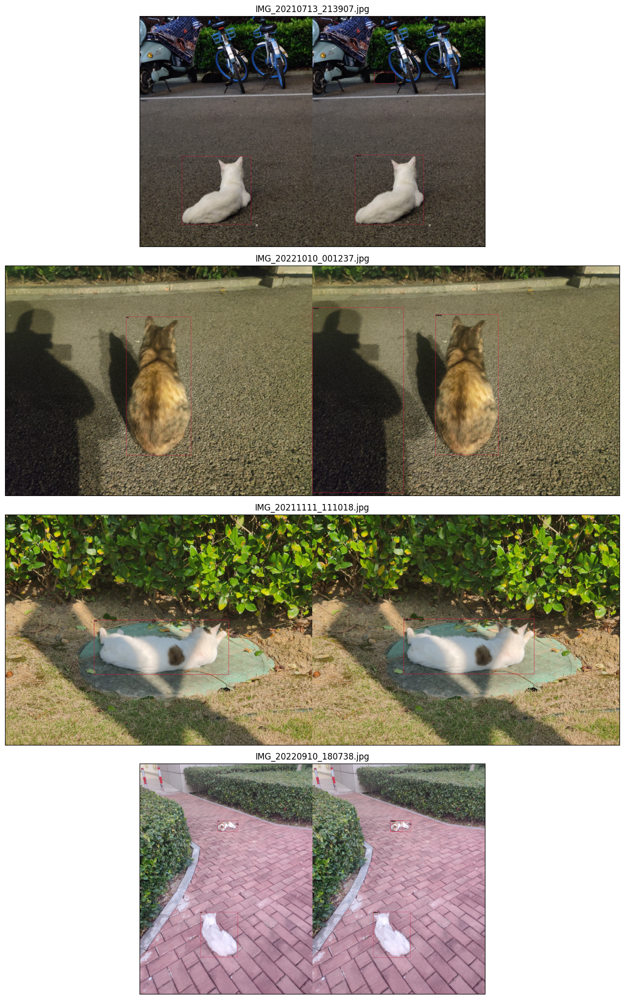

In [6]:
# 数据集可视化
import os
import matplotlib.pyplot as plt
from PIL import Image

get_ipython().run_line_magic('matplotlib', 'inline')

plt.figure(figsize=(20, 20))

# 你如果重新跑，这个时间戳是不一样的，需要自己修改
root_path='work_dirs/rtmdet_tiny_1xb12-40e_cat/20230610_001226/results/'
image_paths= [filename for filename in os.listdir(root_path)][:4]

for i,filename in enumerate(image_paths):
    name = os.path.splitext(filename)[0]

    image = Image.open(root_path+filename).convert("RGB")
  
    plt.subplot(4, 1, i+1)
    plt.imshow(image)
    plt.title(f"{filename}")
    plt.xticks([])
    plt.yticks([])

plt.tight_layout()

In [8]:
# 单张图片进行推理，你可以直接使用 mmdetection/demo/image_demo.py 脚本
!python demo/image_demo.py cat_dataset/images/IMG_20211102_003429.jpg rtmdet_tiny_1xb12-40e_cat.py --weights work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco/bbox_mAP_epoch_30.pth

Loads checkpoint by local backend from path: work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco/bbox_mAP_epoch_30.pth
06/10 12:15:27 - mmengine - WARNING - Failed to search registry with scope "mmdet" in the "function" registry tree. As a workaround, the current "function" registry in "mmengine" is used to build instance. This may cause unexpected failure when running the built modules. Please check whether "mmdet" is a correct scope, or whether the registry is initialized.
06/10 12:15:27 - mmengine - WARNING - `Visualizer` backend is not initialized because save_dir is None.
/home/cine/miniconda3/envs/openmmlab-pose/lib/python3.8/site-packages/torch/func━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━   
tional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be 
required to pass the indexing argument. (Triggered internally at  
../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/cine/Documents/GitHub/mmdet/mmdete

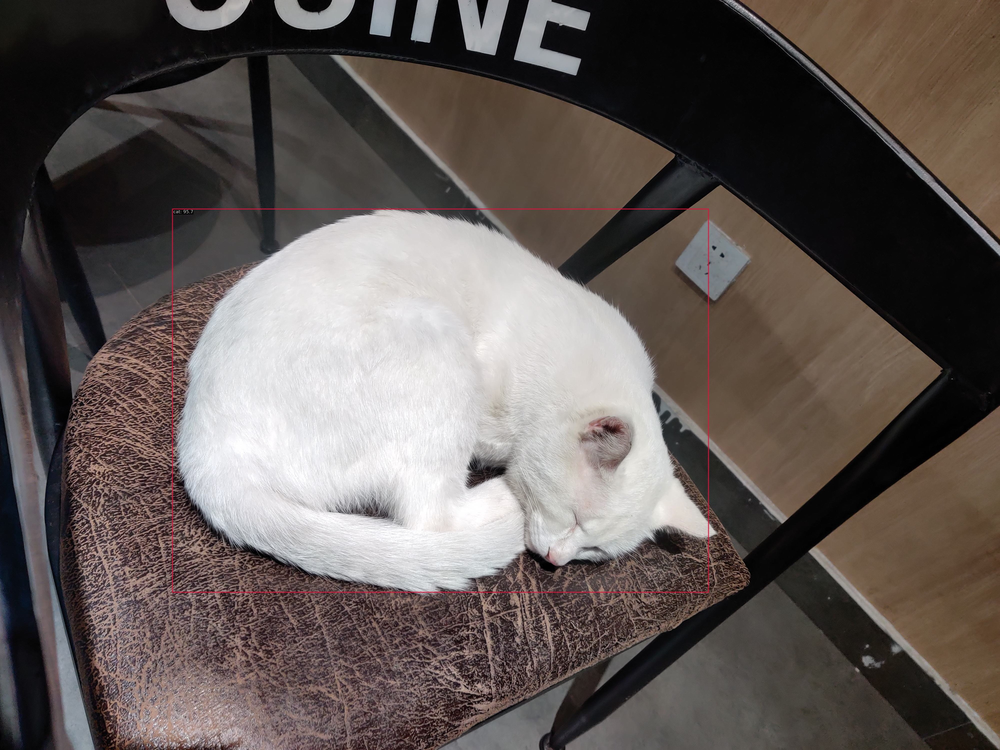

In [9]:
Image.open('outputs/vis/IMG_20211102_003429.jpg')

In [10]:
# # # 可视化分析
# # 可视化分析包括特征图可视化以及类似 Grad CAM 等可视化分析手段。
# # 不过由于 MMDetection 中还没有实现，我们可以直接采用 MMYOLO 中提供的功能和脚本。
# # MMYOLO 是基于 MMDetection 开发，并且此案有了统一的代码组织形式，
# # 因此 MMDetection 配置可以直接在 MMYOLO 中使用，无需更改配置。

# # # MMYOLO 环境和依赖安装


# !pwd
# %cd ../
# !rm -rf mmyolo
# # 为了防止后续更新导致的可能无法运行，特意新建了 tutorials 分支
# !git clone -b tutorials https://github.com/open-mmlab/mmyolo.git 
# %cd mmyolo

# %pip install -e .
# !pwd

# !pip install "grad-cam"

/home/cine/Documents/GitHub/mmdet/mmdetection
/home/cine/Documents/GitHub/mmdet
正克隆到 'mmyolo'...
remote: Enumerating objects: 4898, done.
remote: Counting objects: 100% (289/289), done.
remote: Compressing objects: 100% (172/172), done.
remote: Total 4898 (delta 122), reused 230 (delta 112), pack-reused 4609
接收对象中: 100% (4898/4898), 3.75 MiB | 10.71 MiB/s, 完成.
处理 delta 中: 100% (3011/3011), 完成.
/home/cine/Documents/GitHub/mmdet/mmyolo
Obtaining file:///home/cine/Documents/GitHub/mmdet/mmyolo
  Preparing metadata (setup.py) ... done
  Running setup.py develop for mmyolo
Note: you may need to restart the kernel to use updated packages.
/home/cine/Documents/GitHub/mmdet/mmyolo


In [9]:
!pwd
%cd ../mmyolo

/home/cine/Documents/GitHub/mmdet/mmdetection
/home/cine/Documents/GitHub/mmdet/mmyolo


In [10]:
# %cd mmyolo
import os
import matplotlib.pyplot as plt
from PIL import Image

get_ipython().run_line_magic('matplotlib', 'inline')

In [11]:
# # 图片缩放
# 采用 cat_dataset/images/IMG_20211024_223313.jpg 图片进行后续可视化分析，
# 不过由于这张图片分辨率过大，会导致程序奔溃，因此我们先将其缩放处理

import cv2

img = cv2.imread('../mmdetection/cat_dataset/images/IMG_20211024_223313.jpg')
h,w=img.shape[:2]
resized_img = cv2.resize(img, (640, 640))
cv2.imwrite('resized_image.jpg', resized_img)

True

Loads checkpoint by local backend from path: ../mmdetection/work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco/bbox_mAP_epoch_30.pth
06/10 13:17:24 - mmengine - WARNING - `Visualizer` backend is not initialized because save_dir is None.
[                                                  ] 0/1, elapsed: 0s, ETA:/home/cine/miniconda3/envs/openmmlab-pose/lib/python3.8/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/cine/Documents/GitHub/mmdet/mmdetection/mmdet/visualization/palette.py:90: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.d

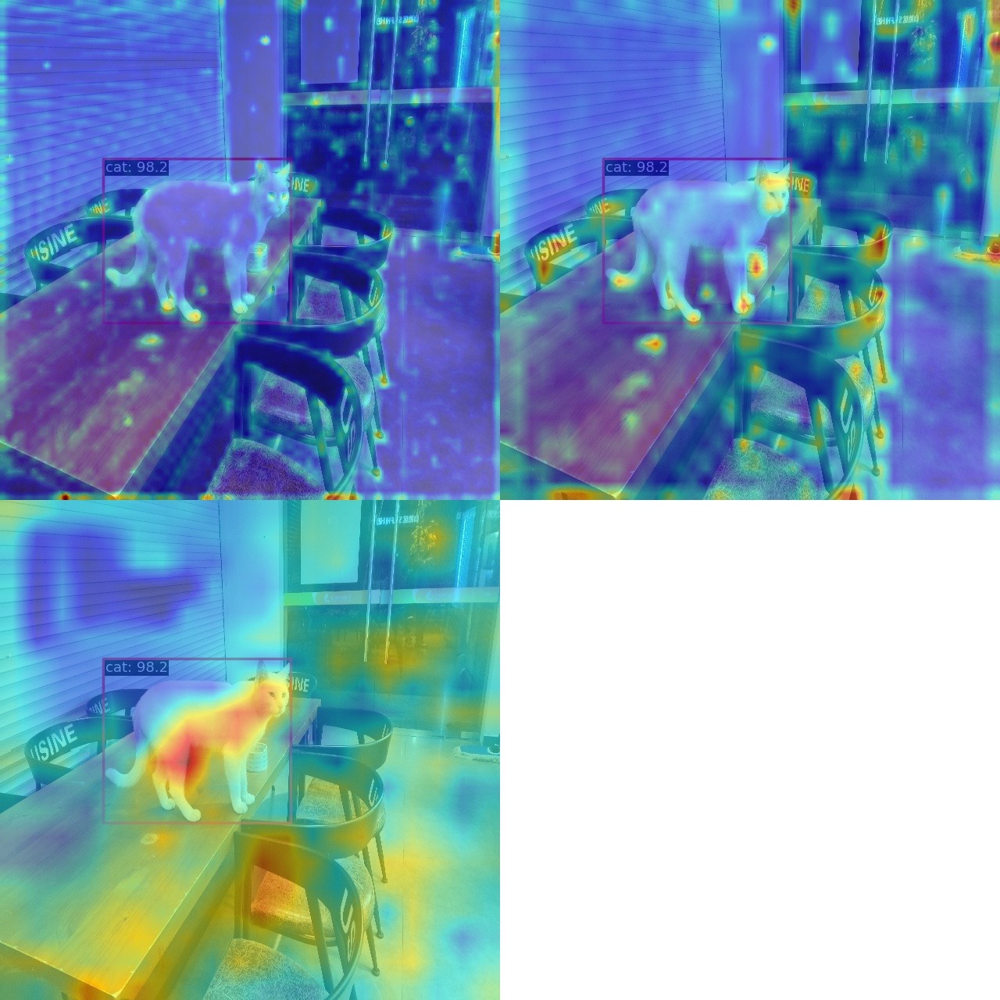

In [12]:
# 1. 可视化 backbone 输出的 3 个通道
!python demo/featmap_vis_demo.py \
      resized_image.jpg \
      ../mmdetection/rtmdet_tiny_1xb12-40e_cat.py \
      ../mmdetection/work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco/bbox_mAP_epoch_30.pth  \
      --target-layers backbone  \
      --channel-reduction squeeze_mean  
pixels1 = Image.open('output/resized_image.jpg')  
pixels1.save("output/resized_image1.jpg")
pixels1

Loads checkpoint by local backend from path: ../mmdetection/work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco/bbox_mAP_epoch_30.pth
06/10 12:54:08 - mmengine - WARNING - `Visualizer` backend is not initialized because save_dir is None.
[                                                  ] 0/1, elapsed: 0s, ETA:/home/cine/miniconda3/envs/openmmlab-pose/lib/python3.8/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/cine/Documents/GitHub/mmdet/mmdetection/mmdet/visualization/palette.py:90: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.d

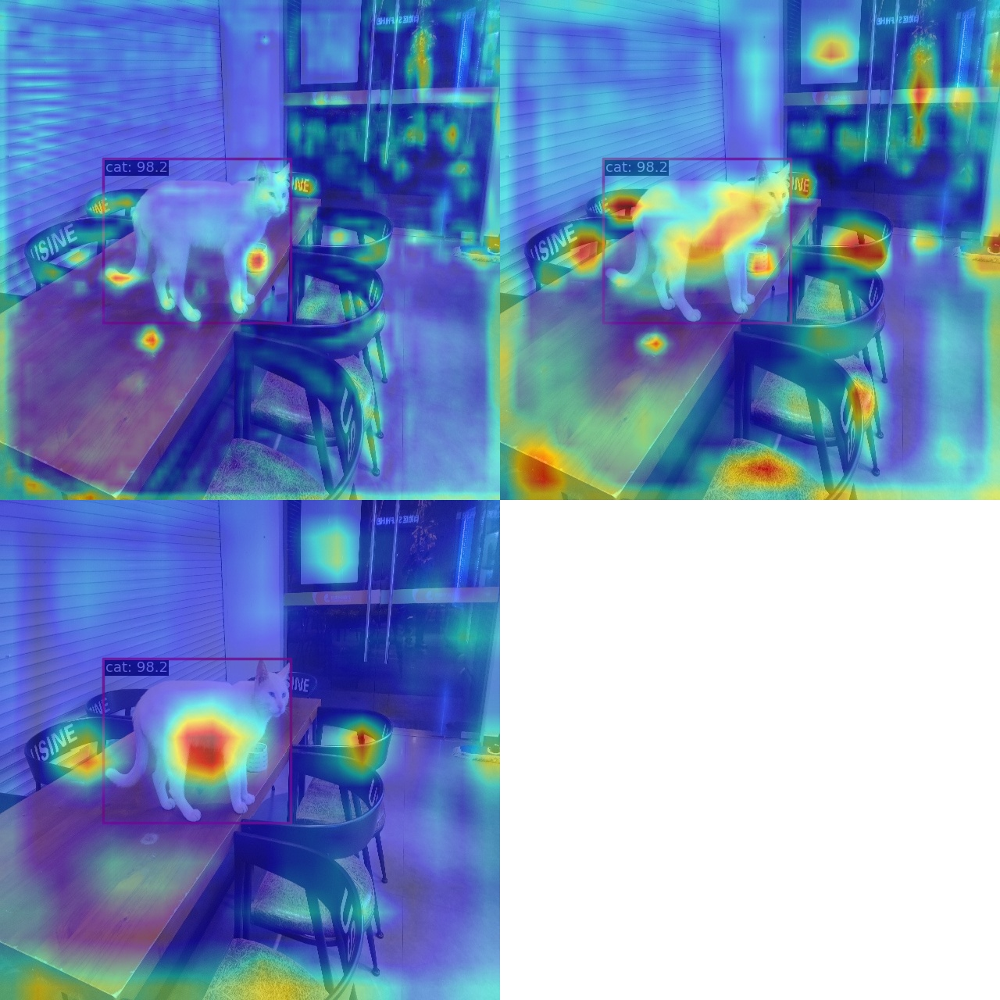

In [5]:
# 2. 可视化 neck 输出的 3 个通道
!python demo/featmap_vis_demo.py \
      resized_image.jpg \
      ../mmdetection/rtmdet_tiny_1xb12-40e_cat.py \
      ../mmdetection/work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco/bbox_mAP_epoch_30.pth  \
      --target-layers neck  \
      --channel-reduction squeeze_mean
pixels1 = Image.open('output/resized_image.jpg')  
pixels1.save("output/resized_image2.jpg")
pixels1

The algorithm currently used is rtmdet
Loads checkpoint by local backend from path: ../mmdetection/work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco/bbox_mAP_epoch_30.pth
[                                                  ] 0/1, elapsed: 0s, ETA:/home/cine/miniconda3/envs/openmmlab-pose/lib/python3.8/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/cine/miniconda3/envs/openmmlab-pose/lib/python3.8/site-packages/torch/nn/functional.py:3631: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn(
[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1/1, 6.3 task/s, elapsed: 0s, ETA:    

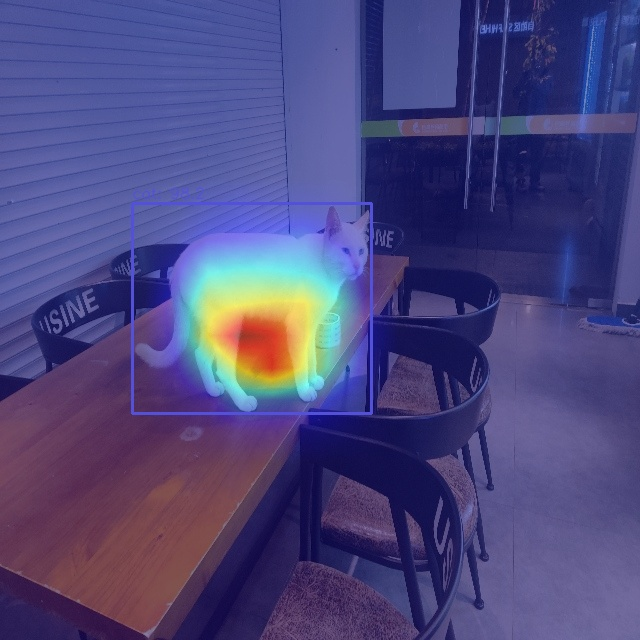

In [6]:
# # Grad-Based CAM 可视化
# 由于目标检测的特殊性，这里实际上可视化的并不是 CAM 而是 Grad Box AM。
# 使用前需要先安装 grad-cam 库
# # !pip install "grad-cam"

# (a) 查看 neck 输出的最小输出特征图的 Grad CAM

!python demo/boxam_vis_demo.py \
      resized_image.jpg \
      ../mmdetection/rtmdet_tiny_1xb12-40e_cat.py \
      ../mmdetection/work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco/bbox_mAP_epoch_30.pth  \
      --target-layer neck.out_convs[2]
pixels1 = Image.open('output/resized_image.jpg')  
pixels1.save("output/resized_image3.jpg")
pixels1      

The algorithm currently used is rtmdet
Loads checkpoint by local backend from path: ../mmdetection/work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco/bbox_mAP_epoch_30.pth
[                                                  ] 0/1, elapsed: 0s, ETA:/home/cine/miniconda3/envs/openmmlab-pose/lib/python3.8/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/cine/miniconda3/envs/openmmlab-pose/lib/python3.8/site-packages/torch/nn/functional.py:3631: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn(
[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1/1, 8.4 task/s, elapsed: 0s, ETA:    

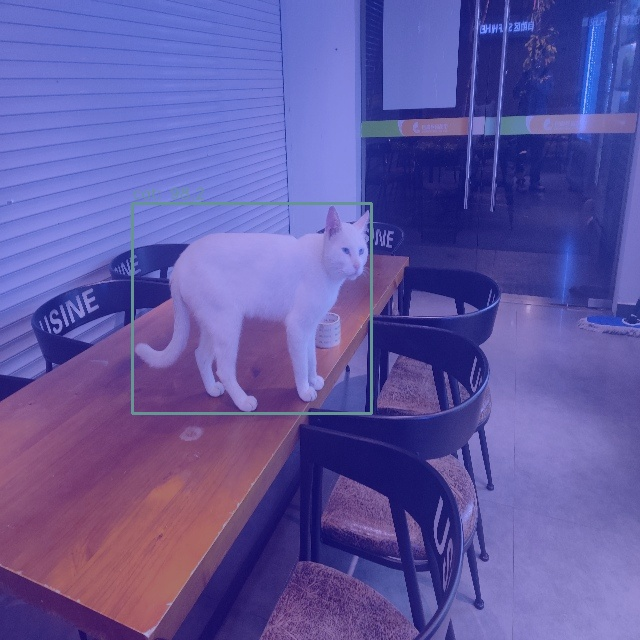

In [7]:
# (b) 查看 neck 输出的最大输出特征图的 Grad CAM

!python demo/boxam_vis_demo.py \
      resized_image.jpg \
      ../mmdetection/rtmdet_tiny_1xb12-40e_cat.py \
      ../mmdetection/work_dirs/rtmdet_tiny_1xb12-40e_cat/best_coco/bbox_mAP_epoch_30.pth  \
      --target-layer neck.out_convs[0]
pixels1 = Image.open('output/resized_image.jpg')  
pixels1.save("output/resized_image4.jpg")
pixels1  